# Visualizing Geospatial Data Using Geopandas Library

### Table of Contents

1. [Introduction](#introduction)
    * [Visualization Technique](#visualization-technique)
    * [Visualization Library](#visualization-library)
2. [Demonstration](#demonstration)
    * [Basic Geospatial Visualization](#basic-visualization)
    * [Advance Choropleth Map Visualization](#advance-visualization)
3. [Resources](#resources)

### 1. Introduction <a class='anchor' id='introduction'></a>





##### <i>Geospatial Visualization Technique</i> <a class="anchor" id="visualization-technique"></a>
Geospatial word comes from a combination of 'Geo' and 'Spatial' which could refers to geographic space. This space could be points or shapes which could represent cities, towns, generic locations, countries etc. Geospatial visualization can help make sense of positional data in space-time dimension. One can use this geospatial data in improving machine learning model with space data being incorporated into the model. One can use this geo-location data in predicting natural disasters in advance or improve agricultural activities based on climate pattern, terrain, or altitude. Policy maker can also use geospatial data in decision making regarding public policies. However, geospatial data can be a bit obscure without visualizing them only cartographic map that people are familiar with. Here, I want to guide you and get your hands wet on geospatial data manipulation, sources and visualization

##### Visualization Library <a class="anchor" id="visualization-library"></a>
There are multiple geospatial visualization library in python including `Folium`, `Matplotlib`, `Rasterio`, `Geopandas` and many more, but the library to also work with the geometry or shape data of GIS format is `Geopandas`. 

GIS data includes at least 4 parts, .SHP, .DBF, .PRJ, .SHX. .SHP file is a geometry of the features, .DBF database spreadsheet containing other data regarding features such as population, GDP etc., .SHX is the index file, and .PRJ is the projection and coordinate system the data uses. There are many public resources which you can download this type of files.

_Why Geopandas is good for geospatial visualization?_

- It works similar to normal `Pandas` Dataframe with addition of geometry column which contain geospatial information from the files mentioned above. This library can
- It can help pre-processing the GIS data into JSON which can be digest by other interactive visualization such as `Folium`
- Allows many geospatial operation such as merging data, splitting large geometry into smaller geometry, vice versa.
- Allows quick exploratory geospatial visualization with simple class function.

_Difficulties with Geopandas_
- Clash in library dependencies can occur during installation
- Cannot configure many chart features by itself, requires other library such as Matplotlib or Folium for more adjustments

##### _Installation_

Use the following command to install Geopandas using conda command
```
conda install -c conda-forge geopandas
```
Should there be any dependencies conflict, try the following installation after to manually includes required libraries
```
conda install pandas fiona shapely pyproj rtree
```

Or use pip to install via the following command
```
pip install geopandas
```
Then you should be able to import Geopandas Library into your code


### 2. Demonstration <a class='anchor' id='demonstration'></a>

##### Basic Geospatial Visualization

We will first need to import geopandas and if you have not already install the package, head back to the installation section

In [28]:
import geopandas as gpd
import warnings
warnings.simplefilter("ignore")

For this basic demonstration of geospatial visualization, we will use Bangkok's districts shapefile which has already pre-downloaded into the folder using below
```
Geopandas.read_file(*arg,  **kwarg)
```

In [2]:
# read shape file of Bangkok districts in this folder
gdf = gpd.read_file('Bangkok_shape/district.shp', encoding='TIS-620') # encoding 'TIS-620' is needed to read Thai characters in the file
gdf.head(3)

,OBJECTID,AREA,dcode,dname,dname_e,pcode,no_female,pname,no_male,no_health,no_temple,no_commu,no_hos,no_sch,geometry
0,29,11804564.0,1025,เขตบางพลัด,Bang Phlat,10,53750,กรุงเทพมหานคร,46569,1,23,46,0,11,"POLYGON ((663924.794 1526162.057, 663895.856 1..."
1,30,16319268.0,1017,เขตห้วยขวาง,Huai Khwang,10,42026,กรุงเทพมหานคร,35694,2,3,25,0,3,"POLYGON ((671711.864 1526487.438, 671710.552 1..."
2,31,17075578.0,1045,เขตวังทองหลาง,Wang Thong Lang,10,62158,กรุงเทพมหานคร,52925,0,1,19,0,3,"POLYGON ((674358.118 1525633.939, 674369.430 1..."


From above `GeoDataFrame` we can see that there is this geometry column which contains the essential shape info for the visualization

In [3]:
gdf.geometry.head()

0    POLYGON ((663924.794 1526162.057, 663895.856 1...
1    POLYGON ((671711.864 1526487.438, 671710.552 1...
2    POLYGON ((674358.118 1525633.939, 674369.430 1...
3    POLYGON ((650975.092 1526253.298, 651115.593 1...
4    POLYGON ((694058.076 1525667.706, 694060.576 1...
Name: geometry, dtype: geometry

One other important concept that we need to be aware of in geospatial referencing is CRS which stands for The Coordinate Reference System. This is important, as GeoDataFrame alone is just a coordinate in an arbitrary space. This CRS tells Geopandas how the data coordinates located on earth, according to difference referencing system.

In [4]:
gdf.crs

<Projected CRS: EPSG:32647>
Name: WGS 84 / UTM zone 47N
Axis Info [cartesian]:
- E[east]: Easting (metre)
- N[north]: Northing (metre)
Area of Use:
- name: World - N hemisphere - 96°E to 102°E - by country
- bounds: (96.0, 0.0, 102.0, 84.0)
Coordinate Operation:
- name: UTM zone 47N
- method: Transverse Mercator
Datum: World Geodetic System 1984
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

Above shows that this Bangkok's district data rely on CRS: EPSG32647. This concept will be useful in the next section. Next we will plot our first geospatial plot using `plot()` method on GeoSeries or GeoDataFrame

<AxesSubplot:>

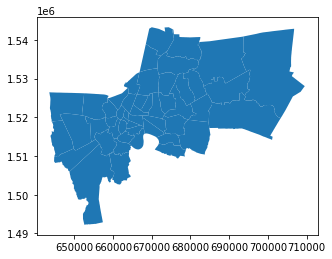

In [5]:
gdf.plot()

##### Advance Choropleth Map Visualization
In this advance Geopandas visualization we will explore 24-hour fire data in Southeast Asia collected through NASA satellites which we can download from [Fire Information for Resource Management System](https://firms.modaps.eosdis.nasa.gov/active_fire/) and [Southeast Asia GIS file](https://databasin.org/datasets/59c48c37d74e4a2db4dbc6997c8eba3b/). Due to recent year, countries in Southeast Asia has been suffering from small air particles (PM2.5 and PM10) which is hazardous, we want to visualize active fire in the region to see where we should aim our effort in curbing the issue.

In [6]:
import geopandas as gpd

Download all the files in the package

In [29]:
fire_data_modis = gpd.read_file('MODIS_C6_1_SouthEast_Asia_24h/MODIS_C6_1_SouthEast_Asia_24h.shp')
fire_data_suomi = gpd.read_file('SUOMI_VIIRS_C2_SouthEast_Asia_24h/SUOMI_VIIRS_C2_SouthEast_Asia_24h.shp')
fire_data_j1 = gpd.read_file('J1_VIIRS_C2_SouthEast_Asia_24h/J1_VIIRS_C2_SouthEast_Asia_24h.shp')
sea_shape = gpd.read_file('Southeast_Asia/cntry_3m.shp') # Source from databasin.org

In [8]:
fire_data_modis.sample(5) # initial look at what does the GeoDataFrame look like

,LATITUDE,LONGITUDE,BRIGHTNESS,SCAN,TRACK,ACQ_DATE,ACQ_TIME,SATELLITE,CONFIDENCE,VERSION,BRIGHT_T31,FRP,DAYNIGHT,geometry
953,18.72934,96.66400,306.48,1.15,1.07,2022-03-19,1533,T,64,6.1NRT,295.71,5.08,N,POINT (96.66400 18.72934)
1092,25.12353,92.88706,304.95,1.52,1.22,2022-03-19,1537,T,62,6.1NRT,293.59,10.73,N,POINT (92.88706 25.12353)
716,22.76929,97.38078,334.16,3.14,1.68,2022-03-19,0616,A,85,6.1NRT,300.28,137.47,D,POINT (97.38078 22.76929)
144,25.78516,91.73958,315.07,1.11,1.05,2022-03-19,0438,T,60,6.1NRT,299.94,7.58,D,POINT (91.73958 25.78516)
1103,26.06339,91.78613,307.35,1.73,1.29,2022-03-19,1537,T,71,6.1NRT,292.75,15.10,N,POINT (91.78613 26.06339)


In [31]:
fire_data_modis.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [33]:
fire_data_modis.dtypes

LATITUDE       float64
LONGITUDE      float64
BRIGHTNESS     float64
SCAN           float64
TRACK          float64
ACQ_DATE        object
ACQ_TIME        object
SATELLITE       object
CONFIDENCE       int64
VERSION         object
BRIGHT_T31     float64
FRP            float64
DAYNIGHT        object
geometry      geometry
dtype: object

Above we can see that the active fire data is in point coordinates, as indicated in column `geometry`, which is expected since the satellite collect coordinates of fire data. Then we want to take a look at the Southeast Asia GIS GeoDataFrame.

In [10]:
sea_shape.sample(5) # shape file for Southeast Asia

,AREA,PERIMETER,CTRY3M_,CTRY3M_ID,COUNTRY,CNTRY_NAME,REGION,CONTINENT,LAND_OCEAN,geometry
733,0.001,0.170,7036,5690,VM,Vietnam,Southeastern Asia,Asia,Island,"POLYGON ((12077580.432 1801793.619, 12077729.9..."
2998,0.203,2.087,10215,7732,ID,Indonesia,Southeastern Asia,Asia,Island,"POLYGON ((14188841.646 -159799.990, 14189459.9..."
3328,0.000,0.068,10696,8178,BP,Solomon Islands,Melanesia,Oceania,Island,"POLYGON ((17734304.409 -606055.004, 17734212.6..."
786,0.000,0.026,7164,5815,RP,Philippines,Southeastern Asia,Asia,Island,"POLYGON ((13383661.633 1662579.675, 13383291.3..."
2748,0.001,0.119,9797,7340,ID,Indonesia,Southeastern Asia,Asia,Island,"POLYGON ((11585850.838 104981.935, 11585636.81..."


We can see that the GeoDataFrame actually contain other region nearby such as Oceanea and Australia. We can filter out only the `REGION` that we want as we would filter DataFrame. Another point to notice in this GeoDataFrame is that country such as the Philippines may have more than one geometry. That is because there are a lot of islands in the country. This is also true for many other countries as well. Geopandas provides a simple method call `dissolve()` to collapes multiple polygon shape based on a grouping column.

In [11]:
sea_shape = sea_shape.dissolve('CNTRY_NAME') #collapse multiple polygon together based on `CNTRY_NAME`, this multiple polygon may due to large number of islands in the region

Here in this next step, I filter the GeoDataFrame to only show Southeast Asia region and you will also notice that I use method `to_crs()` to convert the CRS of the GeoDataFrame to EPSG4326 to be the same as that of the fire GeoDataFrame.

In [12]:
sea = sea_shape[sea_shape['REGION'] == 'Southeastern Asia'].to_crs(epsg=4326).reset_index() 

In [13]:
sea.head()

,CNTRY_NAME,geometry,AREA,PERIMETER,CTRY3M_,CTRY3M_ID,COUNTRY,REGION,CONTINENT,LAND_OCEAN
0,Brunei,"MULTIPOLYGON (((115.01843 4.89579, 115.01250 4...",0.363,3.627,9380,6972,BX,Southeastern Asia,Asia,Island
1,Burma,"MULTIPOLYGON (((97.97078 9.62723, 97.97276 9.6...",57.580,90.616,5792,10984,BM,Southeastern Asia,Asia,Continent
2,Cambodia,"MULTIPOLYGON (((102.91138 9.90555, 102.90721 9...",15.115,25.704,7173,11291,CB,Southeastern Asia,Asia,Continent
3,Indonesia,"MULTIPOLYGON (((122.87543 -10.99916, 122.86665...",0.011,0.581,9199,6921,ID,Southeastern Asia,Asia,Island
4,Laos,"POLYGON ((101.14824 21.57264, 101.14993 21.570...",19.677,42.783,6365,11079,LA,Southeastern Asia,Asia,Continent


Now that we have clean Southeast Asia polygon shape file, we want to take know which fire data coordinates belongs to which country. This may seem near impossible, but with GeoDataFrame, these coordinates can be map onto the shapefile via merging with `sjoin()` method, short for Spatial Join.

In [14]:
fire_country = gpd.sjoin(fire_data_suomi, sea, how='left') # how='left' indicating that we want to keep the geometry of the left data which is fire data.
fire_country.head()

,LATITUDE,LONGITUDE,BRIGHT_TI4,SCAN,TRACK,ACQ_DATE,ACQ_TIME,SATELLITE,CONFIDENCE,VERSION,...,index_right,CNTRY_NAME,AREA,PERIMETER,CTRY3M_,CTRY3M_ID,COUNTRY,REGION,CONTINENT,LAND_OCEAN
0,-5.92812,151.00734,331.31,0.62,0.71,2022-03-19,0236,N,nominal,2.0NRT,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,-5.93187,151.00490,331.20,0.62,0.71,2022-03-19,0236,N,nominal,2.0NRT,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,-5.79133,150.91014,325.10,0.63,0.72,2022-03-19,0236,N,nominal,2.0NRT,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,-4.38546,153.06689,328.80,0.43,0.62,2022-03-19,0236,N,nominal,2.0NRT,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,-0.88132,133.21754,347.29,0.50,0.41,2022-03-19,0417,N,nominal,2.0NRT,...,3.0,Indonesia,0.011,0.581,9199.0,6921.0,ID,Southeastern Asia,Asia,Island


Now, we have multiple fire GeoDataFrame map onto country and region. We then dissolve this GeoDataFrame based on `CNTRY_NAME` as before.

In [15]:
fire_density = fire_country[['CNTRY_NAME', 'BRIGHT_TI4', 'geometry']].dissolve('CNTRY_NAME', aggfunc=['count','mean']) #dissolve is a spatial equivalent of groupby which will aggregate or keep geometry data in the dataframe
fire_density.rename(columns={('BRIGHT_TI4', 'count'):'fire_count', ('BRIGHT_TI4', 'mean'):'brightness_avg' }, inplace=True)

In [16]:
fire_density

,geometry,fire_count,brightness_avg
CNTRY_NAME,,,
Burma,"MULTIPOINT (92.30754 21.10724, 92.30966 21.199...",5015,337.464913
Cambodia,"MULTIPOINT (102.81477 13.78349, 102.81548 13.7...",132,337.557045
Indonesia,"MULTIPOINT (99.48875 1.28786, 99.48997 1.29118...",112,334.342500
Laos,"MULTIPOINT (100.24541 20.72566, 100.37011 20.7...",773,338.649715
Malaysia,"MULTIPOINT (101.60513 2.82193, 102.35706 3.945...",7,318.010000
Philippines,"MULTIPOINT (117.93797 9.07269, 117.98032 9.060...",77,333.808831
Thailand,"MULTIPOINT (97.61864 18.34098, 97.61930 18.335...",256,325.310977
Vietnam,"MULTIPOINT (102.38753 22.32460, 102.39021 22.3...",566,337.123180


With fire GeoDataFrame of points collapsed based on country, now the geometry is a `MULTIPOINT`. However, to plot the chart onto a map, we need polygon geometry of country, hence, we `sjoin()` the geometry back in again.

In [17]:
fire_density_plot = gpd.sjoin(fire_density, sea, how='right').dropna()

In [18]:
fire_density_plot

,index_left,fire_count,brightness_avg,CNTRY_NAME,geometry,AREA,PERIMETER,CTRY3M_,CTRY3M_ID,COUNTRY,REGION,CONTINENT,LAND_OCEAN
1,Burma,5015.0,337.464913,Burma,"MULTIPOLYGON (((97.97078 9.62723, 97.97276 9.6...",57.580,90.616,5792,10984,BM,Southeastern Asia,Asia,Continent
2,Cambodia,132.0,337.557045,Cambodia,"MULTIPOLYGON (((102.91138 9.90555, 102.90721 9...",15.115,25.704,7173,11291,CB,Southeastern Asia,Asia,Continent
3,Indonesia,112.0,334.342500,Indonesia,"MULTIPOLYGON (((122.87543 -10.99916, 122.86665...",0.011,0.581,9199,6921,ID,Southeastern Asia,Asia,Island
4,Laos,773.0,338.649715,Laos,"POLYGON ((101.14824 21.57264, 101.14993 21.570...",19.677,42.783,6365,11079,LA,Southeastern Asia,Asia,Continent
5,Malaysia,7.0,318.010000,Malaysia,"MULTIPOLYGON (((100.53688 3.98749, 100.53609 3...",0.000,0.022,8849,6686,MY,Southeastern Asia,Asia,Island
7,Philippines,77.0,333.808831,Philippines,"MULTIPOLYGON (((119.27054 4.50056, 119.26639 4...",0.000,0.042,6616,5273,RP,Southeastern Asia,Asia,Island
10,Thailand,256.0,325.310977,Thailand,"MULTIPOLYGON (((100.79854 12.71930, 100.80498 ...",43.032,72.237,6703,11286,TH,Southeastern Asia,Asia,Continent
11,Vietnam,566.0,337.123180,Vietnam,"MULTIPOLYGON (((104.83992 8.42555, 104.83998 8...",27.474,80.153,6269,10997,VM,Southeastern Asia,Asia,Continent


From this GeoDataFrame, we can try to plot choropleth map showing the density of fire count in the region.

<AxesSubplot:>

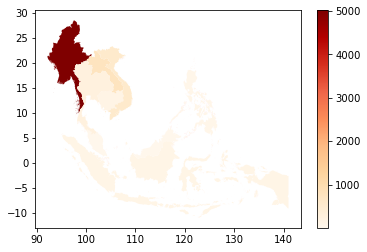

In [19]:
fire_density_plot.plot(column='fire_count', cmap='OrRd', legend=True) # default bin scheme 

The map color is hard to discern since large number of count is in Myanmar, top left while the rest of the count are below 1,000. We adjust this by adding scheme for binning of the data using  `scheme='quantiles', k=7`

<AxesSubplot:>

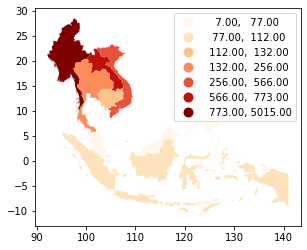

In [20]:
fire_density_plot.plot(column='fire_count',scheme='quantiles', k=7, cmap='OrRd', legend=True)

We can also layer points onto the map as below using `ax=` argument

<AxesSubplot:>

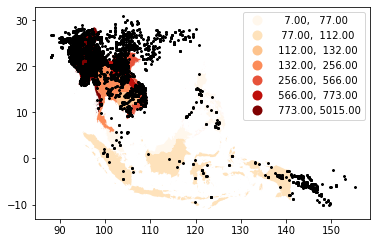

In [21]:
# layering data on top of map
base = fire_density_plot.plot(column='fire_count',scheme='quantiles', k=7, cmap='OrRd', legend=True)
fire_data_suomi.plot(ax=base, marker='x', color='black', markersize=4)

We can also create a simple exploratory interactive choropleth map with `Geopandas.GeoDataFrame.explore()`

In [22]:
# create interactive plot using geopandas.GeoDataFrame.explore
fire_density_plot[['index_left', 'geometry', 'fire_count', 'brightness_avg']].explore(column='fire_count', # make choropleth based on "fire_count" column
     scheme='quantiles', k=7,
     tooltip="index_left", # show value in tooltip (on hover)
     highlight=True,
     popup=True, # show all values in popup (on click)
     tiles="CartoDB positron",
     cmap='plasma', # use matplotlib colormap
     style_kwds=dict(color="black") # use black outline
)

Similar to `Geopandas.GeoDataFrame.plot()`, we can layer with `explore()` method using `m=` argument

In [23]:
# add layer to interactivity
map = fire_density_plot[['index_left', 'geometry', 'fire_count', 'brightness_avg']].explore(column='fire_count', # make choropleth based on "BoroName" column
     scheme='quantiles', k=7,
     tooltip="index_left", # show value in tooltip (on hover)
     highlight=True,
     popup=True, # show all values in popup (on click)
     tiles="CartoDB positron",
     cmap='plasma', # use matplotlib colormap
     style_kwds=dict(color="black") # use black outline
)
fire_data_suomi.explore(m=map, color='black')


In [24]:
russia_df= gpd.read_file('SUOMI_VIIRS_C2_Russia_Asia_24h/SUOMI_VIIRS_C2_Russia_Asia_24h.shp')

In [25]:
russia_df.head()

,LATITUDE,LONGITUDE,BRIGHT_TI4,SCAN,TRACK,ACQ_DATE,ACQ_TIME,SATELLITE,CONFIDENCE,VERSION,BRIGHT_TI5,FRP,DAYNIGHT,geometry
0,59.14942,37.86491,324.91,0.56,0.43,2022-03-22,0033,N,nominal,2.0NRT,276.19,4.67,N,POINT (37.86491 59.14942)
1,59.15023,37.84365,312.59,0.56,0.43,2022-03-22,0033,N,nominal,2.0NRT,274.87,2.26,N,POINT (37.84365 59.15023)
2,59.14441,37.84924,303.52,0.56,0.43,2022-03-22,0033,N,nominal,2.0NRT,275.06,2.26,N,POINT (37.84924 59.14441)
3,59.14017,37.81246,311.18,0.56,0.43,2022-03-22,0033,N,nominal,2.0NRT,269.14,2.28,N,POINT (37.81246 59.14017)
4,59.14918,37.83591,315.41,0.56,0.43,2022-03-22,0033,N,nominal,2.0NRT,276.47,3.67,N,POINT (37.83591 59.14918)


In [32]:
russia_df.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [26]:
russia_df.explore()

In [27]:
russia_df[russia_df.]

SyntaxError: invalid syntax (3614046959.py, line 1)

### 3. Resources

1. https://geopandas.org/en/stable/index.html
2. https://firms.modaps.eosdis.nasa.gov/active_fire/#firms-shapefile
3. https://towardsdatascience.com/geopandas-hands-on-building-geospatial-machine-learning-pipeline-9ea8ae276a15
4. https://towardsdatascience.com/interactive-geographical-maps-with-geopandas-4586a9d7cc10
5. https://geographicdata.science/book/intro.html#
6. https://databasin.org/datasets/59c48c37d74e4a2db4dbc6997c8eba3b/
7. http://www.bangkokgis.com/modules.php?m=download_shapefile
